<a href="https://colab.research.google.com/github/taesangeom/SK-T-Academy/blob/main/DL/InceptionNet/0_Intro_class.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
CV : Computer Vision
# --> EE/ CS
# --> DL + 살아난 분야!!!
# --> 개인적인 부분 : DL( 직접적으로 오는 분야는 하나가 영상 )
# + 관련 연구/ 패키지 : openCV[ c, c++, python etc] + matlab(실험이 용이...)
# opencv : 전통 비전에 초점이 있다보니,,최신 알고리즘 업데이트가 느린,,
#                                       방식이 예전 전통 비전 방식의 모델 주로...
# --> 전처리에 워낙 많이 개발을 해둬서 편히 사용이 가능함!!!!!

# 컴퓨터가 바라보는 이미지

##### 필요한 패키지들

In [ ]:
### 컴퓨터가 바라보는 이미지 파일에 대한 이해 ####
### ==> 일반적인 이미지 데이터를 가지고 핸들링!!!!
### ==> openCV : C/Java/python etc
### ==> 파이썬 계열에서는 cv2라고 되어 있음....
### ==> 본인 pc에서 하기 위해서는 설치를 하셔야 함!!!
#       ++ 클라우드를 사용하시면 직접 설치를 하고 사용해야 함!!! anaconda의 기본 패키지X

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.cm as cm
import numpy as np
##############
import cv2
import os
##############

In [ ]:
cv2.__version__
# colab 기준으로 임..
# ==> 프로젝트 하실 때 참조하는 cv버전이 예전 버전이면,,,에러 발생을 함!!!!
#     + 다른 패키지 ( torch 계열하고 충돌이 날 때가 있음!!!!)
# ==> 귀찮지만,,문제가 생기면,,,버전 매칭을 해결해야 함!!!!!! + 코드 수정을 해야하는 경우도 있음!!

'4.10.0'

##### 이미지 파일과 색공간

* 이미지와 색공간
- **0 ~ 255 사이의 값**으로 밝기를 표현

- color: 3차원 (true color 라고도 불림)

  <img src="https://upload.wikimedia.org/wikipedia/commons/8/83/RGB_Cube_Show_lowgamma_cutout_b.png" width="500">
  <img src="https://upload.wikimedia.org/wikipedia/commons/b/b0/RGB_color_space_animated_view.gif">

  <img src="https://upload.wikimedia.org/wikipedia/commons/thumb/3/33/Beyoglu_4671_tricolor.png/400px-Beyoglu_4671_tricolor.png" width="600">

  <sub>[이미지 출처] https://en.wikipedia.org/wiki/RGB_color_space  
  https://commons.wikimedia.org/wiki/File:RGB_color_space_animated_view.gif</sub>

- gray scale: 2차원
  - 0~255의 값을 통해 밝기를 표현
  - 0으로 갈수록 어두워지고, 255로 갈수록 밝아짐

  <img src="https://miro.medium.com/max/1400/1*euc4RxnNo78LFEGrb-QZ7w.jpeg">

  <sub>[이미지 출처] https://medium.com/@himnickson/converting-rgb-image-to-the-grayscale-image-in-java-9e1edc5bd6e7</sub>
  
  <img src="https://ai.stanford.edu/~syyeung/cvweb/Pictures1/imagematrix.png">

  <sub>[이미지 출처] https://ai.stanford.edu/~syyeung/cvweb/tutorial1.html</sub>

##### 이미지 파일 형식

- BMP
  - 픽셀 데이터를 압축하지 않은 상태로 저장

  - 파일 구조 간단하지만 용량이 매우 큼

- JPG(JPEG)
  - 손실 압축(lossy compression) 사용

  - 원본 영상으로부터 픽셀값이 미세하게 달라짐

  - 파일 용량 크기가 크게 감소하는 점에서 장점

  - 디지털 카메라

- GIF
  - 무손실 압축(losses compression)

  - 움직이는 그림인 Animation GIF 지원

  - **256 이하의 색상을 가진 영상만을 저장**하고, 화질이 매우 떨어짐

- PNG
  - Portable Network Graphics

  - 무손실 압축 사용

  - 용량은 큰 편이지만 픽셀값이 변경되지 않음

  - $\alpha$ 채널을 지원하여 일부분을 투명하게 설정 가능

In [ ]:
# 현실적으로 프로젝트를 하시다 보면,,
# ==> 여러 사이트에서 수집을 하는 경우가 대부분일 것!!!
# ==> 사이트별로 이미지의 포멧이 각양 각색!!!
#     수집하실 때 : 원본, ( 모델을 학습을 위한 공통적인 양식, 크기 etc ) + opencv

##### 실습 : 이미지 파일 불러오기

In [ ]:
# 직접 업로드해도 됨!!
# 여기서는 파일을 다운 받아서 하기 위해서 다운을 받은 것임.
!gdown 1cHcUDb4ziI6UKr4Xq1aLRqS8JCNM-aHf

Downloading...
From: https://drive.google.com/uc?id=1cHcUDb4ziI6UKr4Xq1aLRqS8JCNM-aHf
To: /content/sohn.jpg
100% 339k/339k [00:00<00:00, 76.3MB/s]


In [ ]:
img_path = '/content/sohn.jpg'
image = cv2.imread(img_path)
print(image.shape)

(1496, 2047, 3)


In [ ]:
image

array([[[28, 33, 32],
        [28, 33, 32],
        [29, 34, 33],
        ...,
        [17, 17, 17],
        [18, 18, 18],
        [19, 19, 19]],

       [[28, 33, 32],
        [29, 34, 33],
        [29, 34, 33],
        ...,
        [17, 17, 17],
        [17, 17, 17],
        [17, 17, 17]],

       [[29, 34, 33],
        [29, 34, 33],
        [29, 34, 33],
        ...,
        [17, 17, 17],
        [17, 17, 17],
        [16, 16, 16]],

       ...,

       [[27, 18, 21],
        [29, 20, 23],
        [32, 23, 26],
        ...,
        [49, 37, 37],
        [50, 38, 38],
        [50, 38, 38]],

       [[29, 20, 23],
        [30, 21, 24],
        [31, 22, 25],
        ...,
        [49, 37, 37],
        [49, 37, 37],
        [49, 37, 37]],

       [[31, 22, 25],
        [30, 21, 24],
        [29, 20, 23],
        ...,
        [49, 37, 37],
        [49, 37, 37],
        [48, 36, 36]]], dtype=uint8)

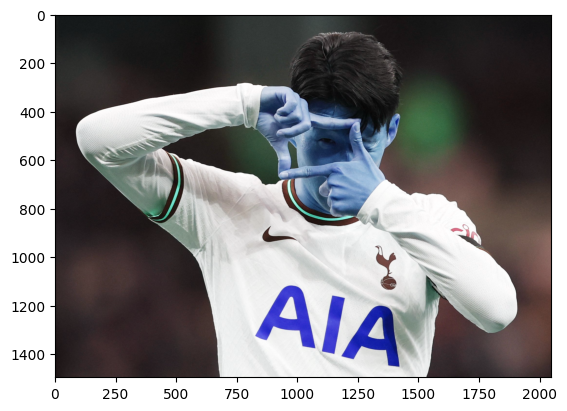

In [ ]:
plt.imshow(image)

# 참고) 일반적인 cv하고, Colab에서의 cv가 좀 다르다!!!!

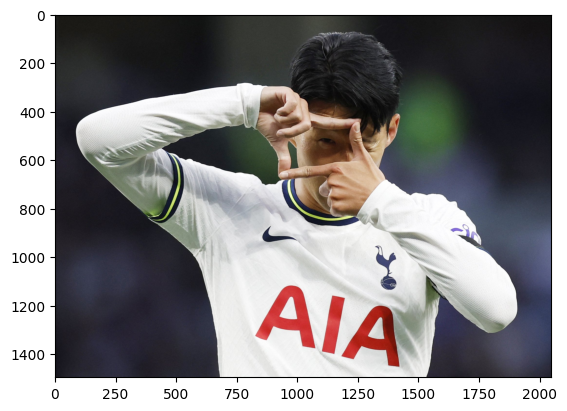

In [ ]:
# colab에선즌 위와 같이...이미지의 컬러에 대한 채널 순서를 다르게 사용!!
# ==> goole에서 수정을 해서 자기네 colab에서 사용하기 때문임!!!!
# RGB ---> BGR

# 내가 원하는 채널의 순서대로 변경이 가능함!!!
imageRGB = cv2.cvtColor( image, cv2.COLOR_BGR2RGB)
plt.imshow(imageRGB)

In [ ]:
from google.colab.patches import cv2_imshow
#cv2.imshow 함수를 cv2_imshow로 변경한다.
# cv2_imshow(img)
# ==> colab에서 기존 cv2의 이미지 출력의 메서드를 호흥하기 위해서 새로 만든것!!
# 본인 local/ 개별 pc에서는 이 모듈 없음!!!

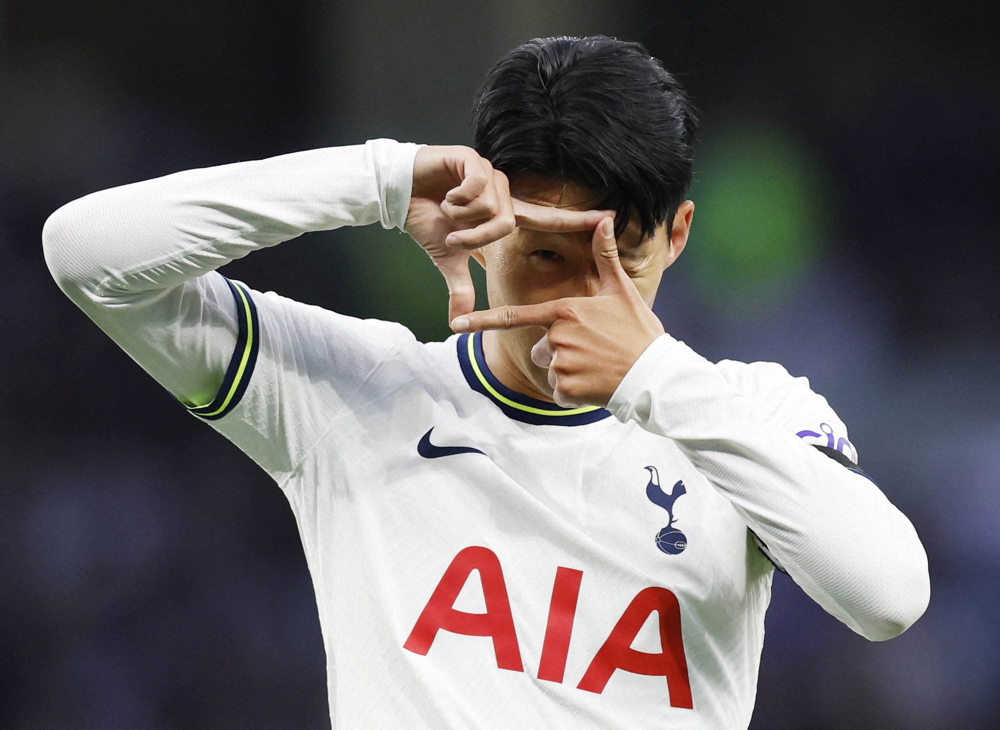

In [ ]:
img = cv2.imread(img_path)
cv2_imshow( img )

# 이미지 정보들 확인 : 모양/채널/ 채널분리 및 병합 관련

In [ ]:
type(img)
# --> opencv로 이미지를 불러오면 기본 자료형이 numpy array
#     + 벡터연산, 슬라이싱

numpy.ndarray

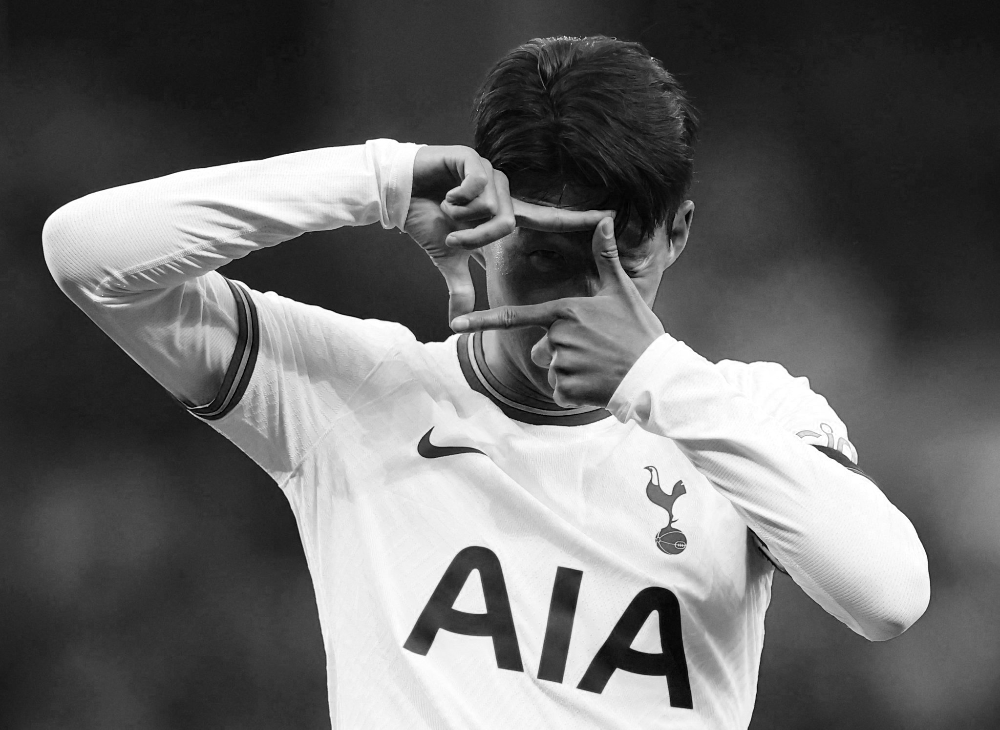

In [ ]:
# RGB에서 하나의 판만 가지고 오겠다!!!1
cv2_imshow( img[:,:,0])

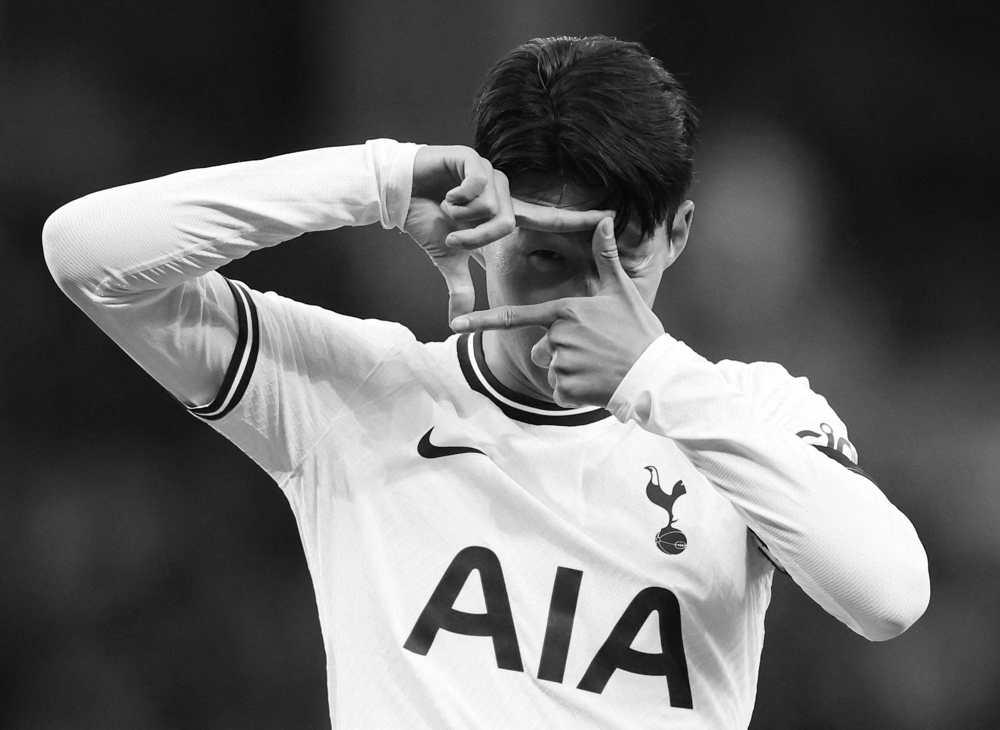

In [ ]:
cv2_imshow( img[:,:,1])

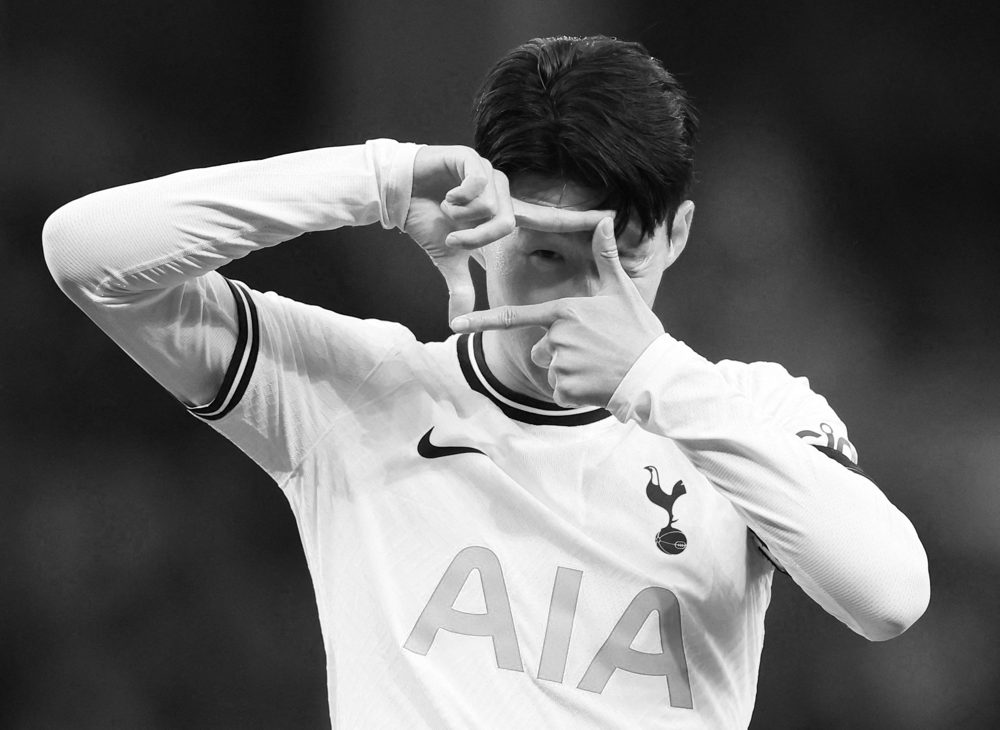

In [ ]:
cv2_imshow( img[:,:,2])

In [ ]:
# 간단하게 흑백 이미지를 만드는 방법으로 채널을 단순 분리 방법!!!
# --> 위에서 본 대로...
# --> 특정 채널의 특성이 반영이 됨!!!!
# ==> 명시적으로 컬러를 흑백으로 변경하는 모듈을 사용해서 하는 것을 추천!!!!!

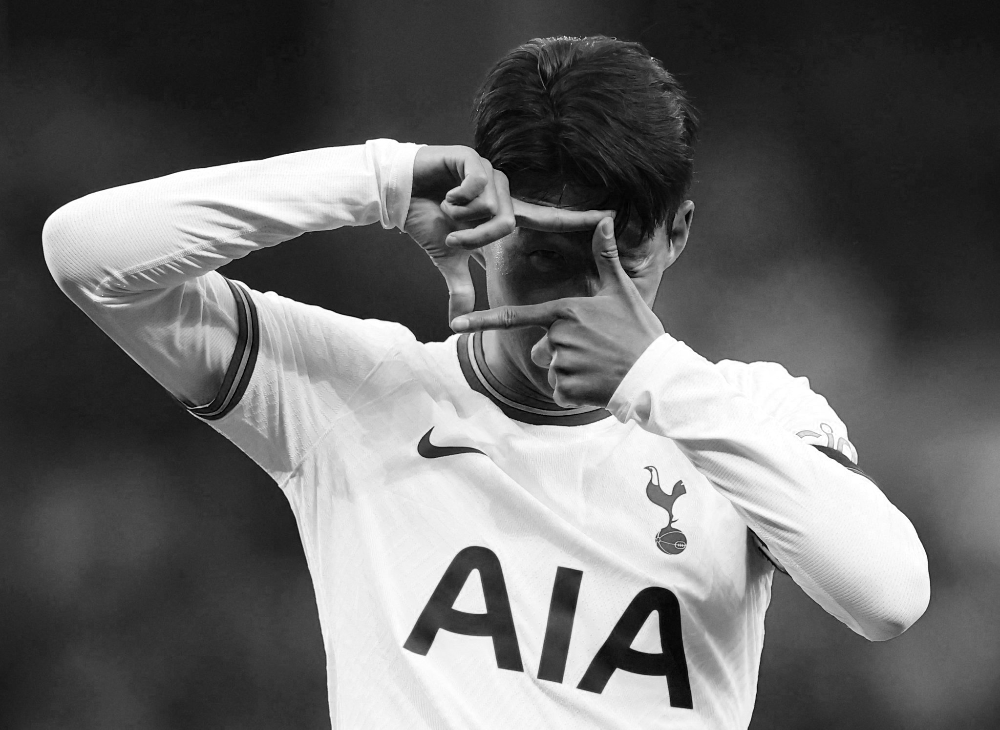

None


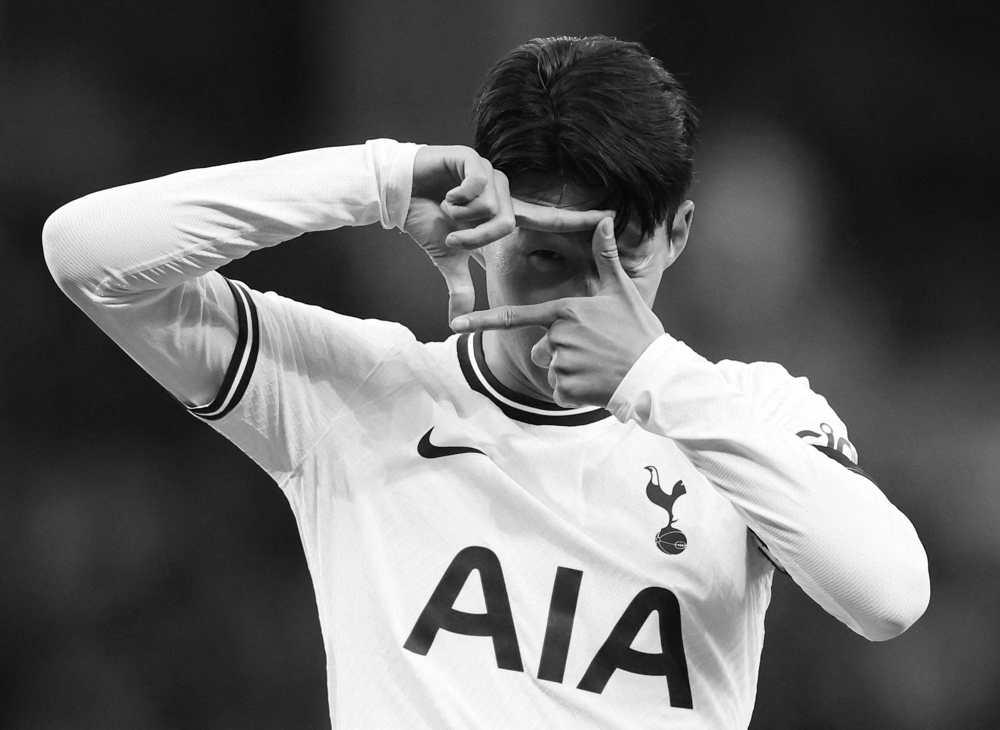

None


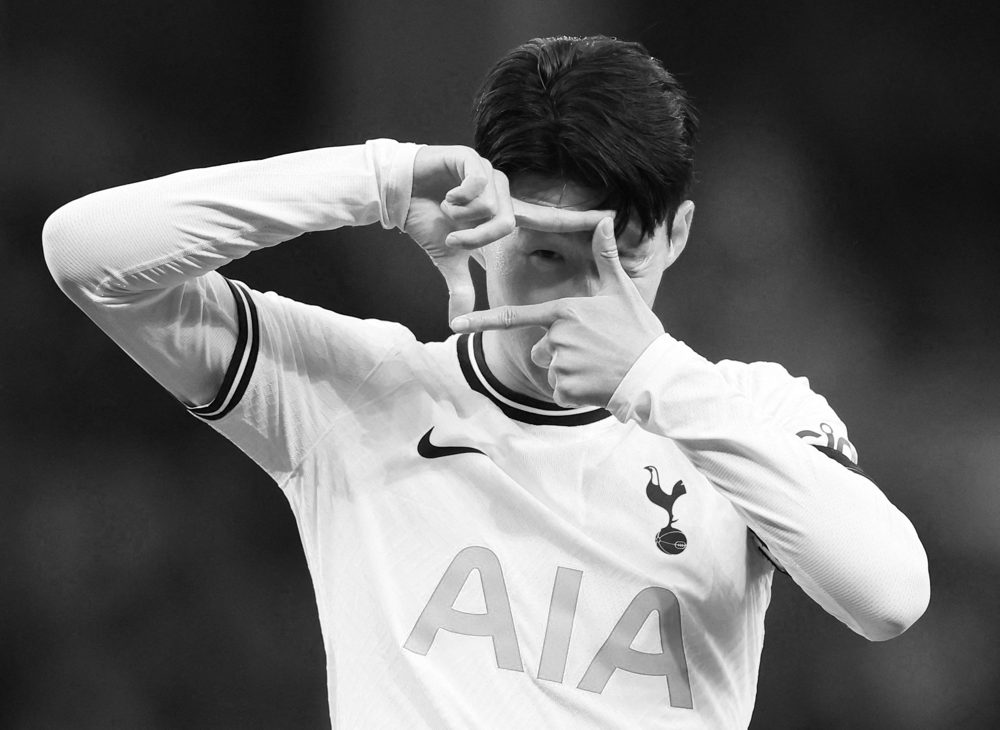

None


In [ ]:
# 참고) 인덱스를 사용하지 않고,,,분리가 가능함!!!
# ==> 파이썬의 멀티 할당!!!!!!
r,g,b = cv2.split( img)
print(cv2_imshow(r))
print(cv2_imshow(g))
print(cv2_imshow(b))

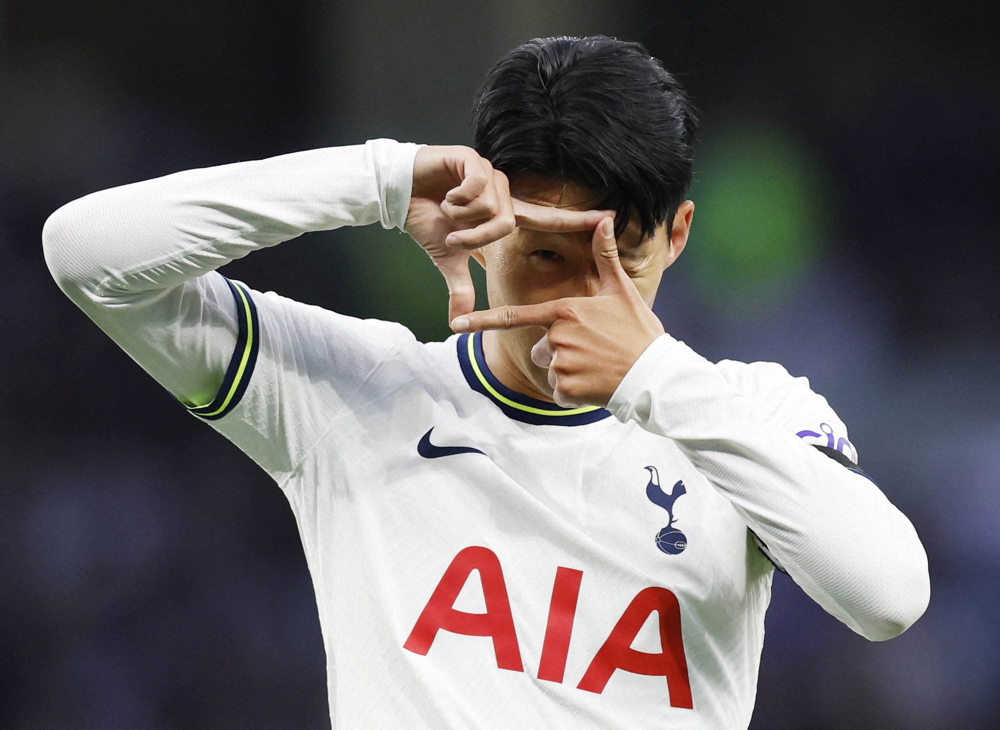

In [ ]:
# 참고) 분리된 채널을 합치는 경우...
temp = cv2.merge([ r,g,b])
cv2_imshow(temp)

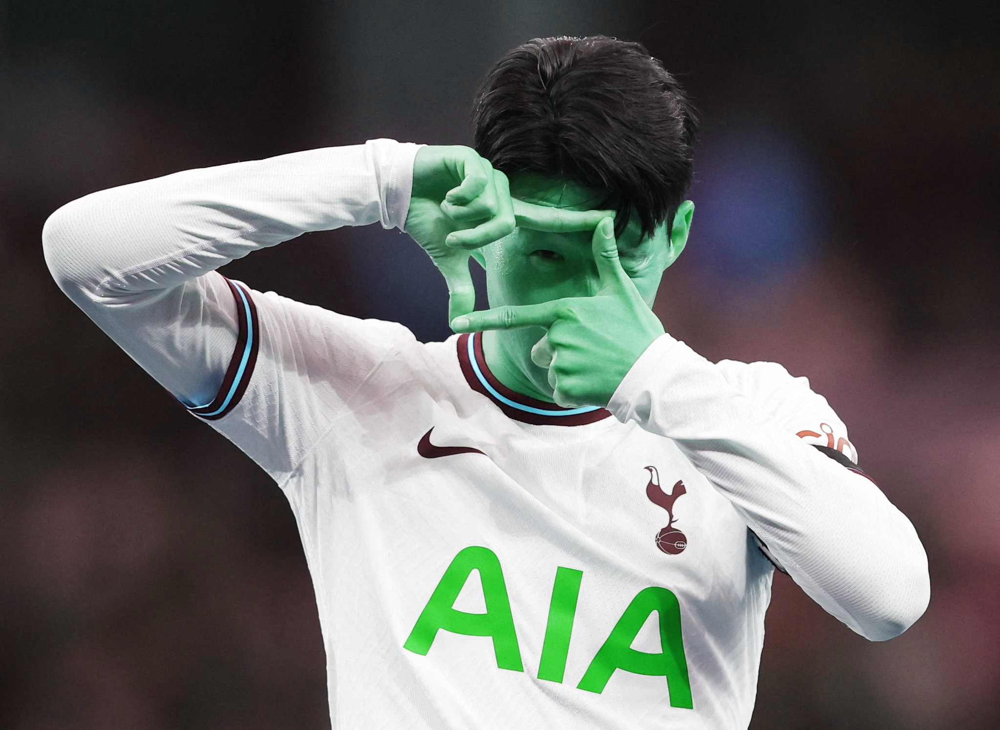

In [ ]:
# 참고) 분리된 채널을 합치는 경우...
temp = cv2.merge([ g,b,r])
cv2_imshow(temp)

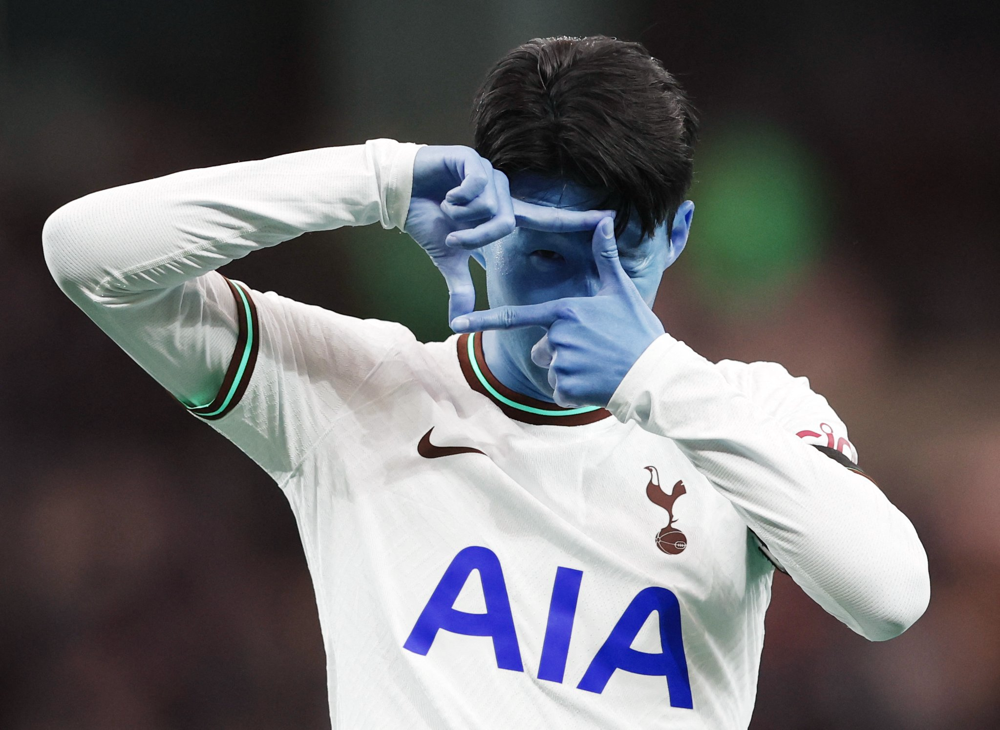

In [ ]:
# 참고) 분리된 채널을 합치는 경우...
temp = cv2.merge([b,g,r])
cv2_imshow(temp)

In [ ]:
# 참고) FM적으로 컬러이미지를 채널의 정보를 줄이기 위해서 흑백!!!!
g = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
# ==> RGB --> GRAY
#      3D      2D
print(img.shape)
print(g.shape)
# ===> 데이터의 차원의 변경이 될 수 있으니 유의해야 함!!!!
#      DL에서는 코드를 수정해야하는 경우가 있을 수 있음input_shape!!!!!

(1496, 2047, 3)
(1496, 2047)


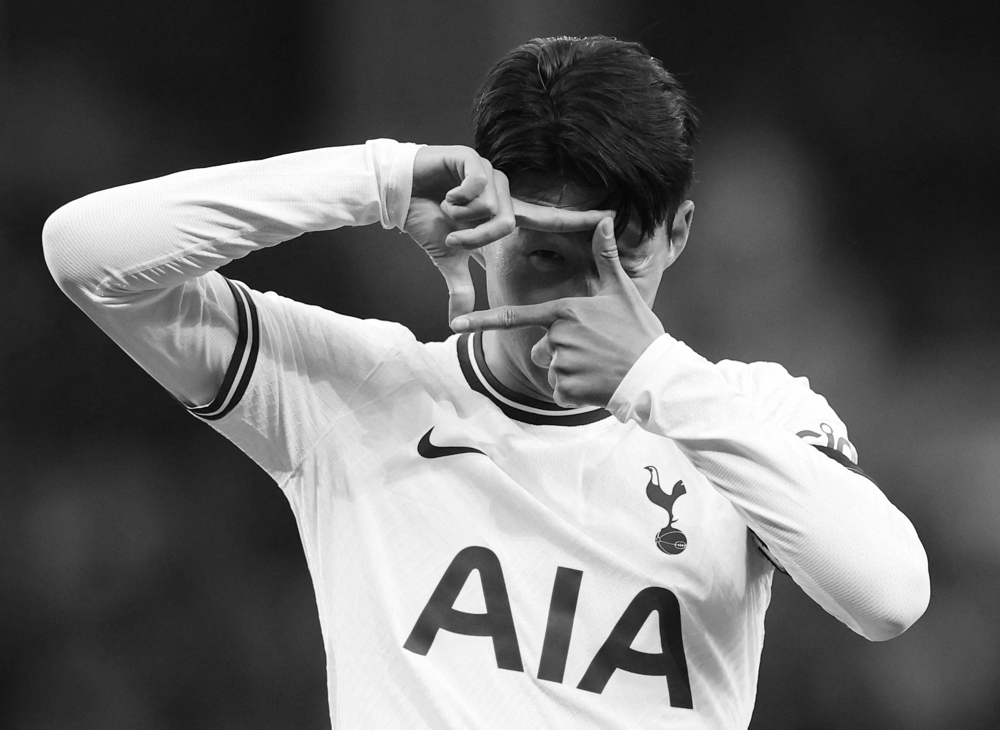

In [ ]:
cv2_imshow(g)

# 이미지 색상 공간의 변환 :color space convert

Org RGB Image Shape: (1496, 2047, 3)
Gray Sclae Image Shape: (1496, 2047)


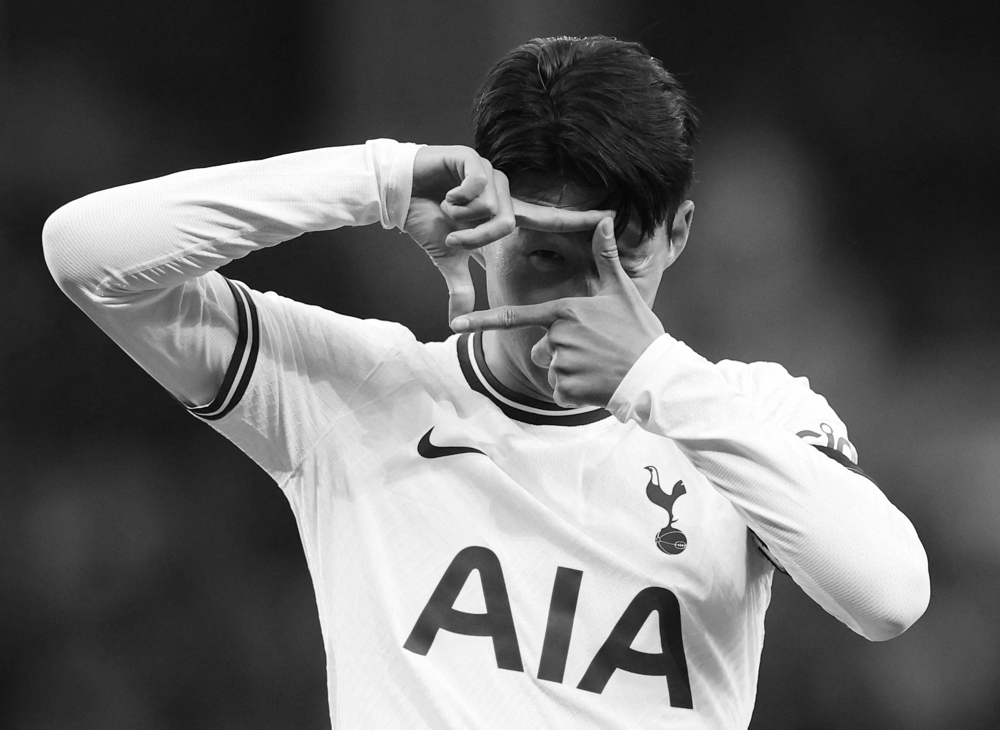

# 간단한 이미지 변환들

### 옆으로 이미지 밀기

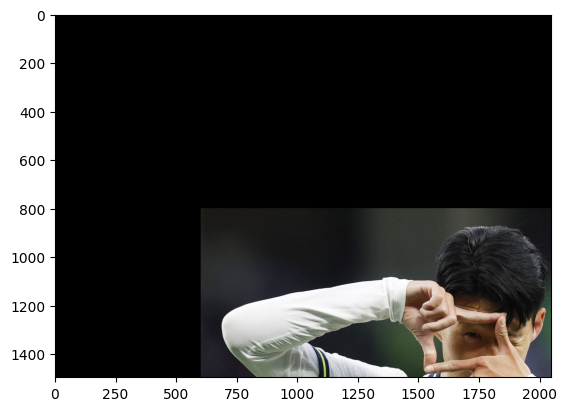

In [ ]:
tx = 600
ty = 800

translation_matrix = np.float32([[1, 0, tx], [0, 1, ty]])
translated_image = cv2.warpAffine(imageRGB, translation_matrix, (image.shape[1], image.shape[0]))

plt.imshow(translated_image)

### 이미지 돌리기

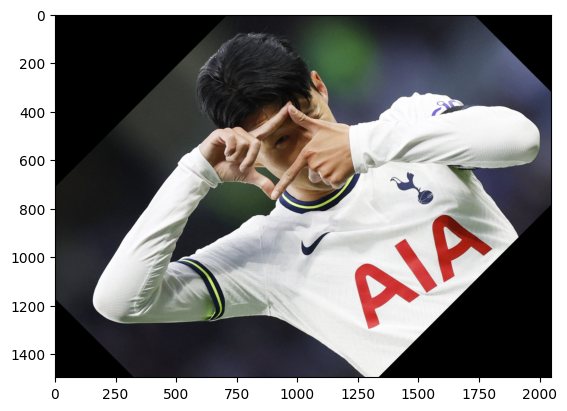

In [ ]:
angle = 45

height, width = imageRGB.shape[:2]
center = (width // 2, height // 2)

rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)
rotated_image = cv2.warpAffine(imageRGB, rotation_matrix, (width, height))

plt.imshow(rotated_image)

### 해상도

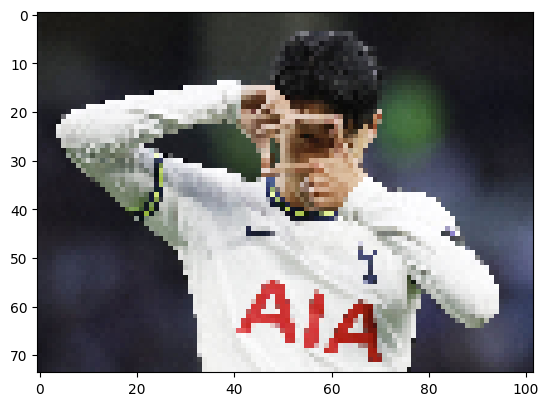

In [ ]:
scale_width = 0.05
scale_height = 0.05

new_width = int(imageRGB.shape[1] * scale_width)
new_height = int(imageRGB.shape[0] * scale_height)

scaled_image = cv2.resize(imageRGB, (new_width, new_height))

plt.imshow(scaled_image)

In [ ]:
# ===> 개별 이미지에 대한 전처리를 주로 opencv를 활용하면
#      다 이미 개발을 해뒀기에,,그냥 가져다가만 사용하면 됨!!!
#      이미지 관련 전처리에는 opencv를 자주 사용을 함!!!
#      물론  tf에서도 이미지 전처리 모듈이 있기는 있음!!!
#      단, 이미지 보강/증강을 위해서는 굳이 내가 안 만들고 하기 위해서는.
#      imagegeneraotr 모듈을 사용해서 ,옵션화 시킨!!!( 회전, 이동, 해상동,,,)
#      : 이제는 옵션으로 이미지 증강에 대한 모듈화로 다 넘김!!!!!

# 단, colab에서 하실 떄에는 RGB가 아니라 BGR로 컬러의 채널이 다르게 온다!!
# ==> 스머프 현상이 있으면,,불러올 때 RGB로 부르던가, 채널의 순서를 변경하던가..
#     + plt.imshow(), cv2_imshow() etc
#     단, cv2.imshow()는 colab에서는 지원을 안 함!!!!!!!